### Overview

This notebook outlines my full approach to project 1 of the class 人工智能与商业创新。


Name: 孟念 (Niklas Muennighoff)

#### Data Setup

In this module we will donwload and prepare the dataset.

The dataset is made available on the challenge website: https://wsss4luad.grand-challenge.org/Datasets/

##### Download Dataset

In [1]:
!pip install -q gdown

In [2]:
import gdown

# Links:
#https://drive.google.com/file/d/1RRXVk9OgQazsamjFiYURqHr1JjXDJLMh/view?usp=sharing
#https://drive.google.com/file/d/1rhz5mQg_qmgBRDxNQEmL79O-9jXNzNYo/view?usp=sharing
#https://drive.google.com/file/d/1FamOrolmNuCjuhrIB8IP9vCPRt3WDmbX/view?usp=sharing

url_train = 'https://drive.google.com/uc?id=1RRXVk9OgQazsamjFiYURqHr1JjXDJLMh'
url_val = "https://drive.google.com/uc?id=1rhz5mQg_qmgBRDxNQEmL79O-9jXNzNYo"
url_test = "https://drive.google.com/uc?id=1FamOrolmNuCjuhrIB8IP9vCPRt3WDmbX"

output_train = '/content/train.zip'
output_val = '/content/val.zip'
output_test = '/content/test.zip'

gdown.download(url_train, output_train, quiet=False)
gdown.download(url_val, output_val, quiet=False)
gdown.download(url_test, output_test, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1RRXVk9OgQazsamjFiYURqHr1JjXDJLMh
To: /content/train.zip
100%|██████████| 1.23G/1.23G [00:11<00:00, 111MB/s] 
Downloading...
From: https://drive.google.com/uc?id=1rhz5mQg_qmgBRDxNQEmL79O-9jXNzNYo
To: /content/val.zip
100%|██████████| 158M/158M [00:02<00:00, 58.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1FamOrolmNuCjuhrIB8IP9vCPRt3WDmbX
To: /content/test.zip
100%|██████████| 245M/245M [00:06<00:00, 40.4MB/s]


'/content/test.zip'

In [3]:
!unzip /content/train.zip -d train
!unzip /content/val.zip -d val
!unzip /content/test.zip -d test

Streaming output truncated to the last 5000 lines.
  inflating: train/1.training/1003370-11223-11698-[1, 1, 0].png  
  inflating: train/1.training/1003370-11223-18822-[1, 1, 0].png  
  inflating: train/1.training/1003370-11223-20603-[1, 1, 0].png  
  inflating: train/1.training/1003370-11223-33070-[1, 1, 0].png  
  inflating: train/1.training/1003370-11223-34851-[1, 1, 0].png  
  inflating: train/1.training/1003370-11223-36632-[1, 1, 0].png  
  inflating: train/1.training/1003370-13087-20603-[1, 1, 0].png  
  inflating: train/1.training/1003370-14951-8136-[1, 1, 0].png  
  inflating: train/1.training/1003370-14951-9917-[1, 1, 0].png  
  inflating: train/1.training/1003370-14951-17041-[1, 1, 0].png  
  inflating: train/1.training/1003370-16815-4574-[1, 1, 0].png  
  inflating: train/1.training/1003370-16815-9917-[1, 1, 0].png  
  inflating: train/1.training/1003370-16815-34851-[1, 1, 0].png  
  inflating: train/1.training/1003370-18679-13479-[1, 1, 0].png  
  inflating: train/1.training

##### Process dataset into dataloaders

We define several data augmentations such as rotations to increase our training data size.

In [4]:
from torchvision import datasets, models, transforms

data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop((224, 224)),
        transforms.RandomVerticalFlip(p=0.5),
        transforms.RandomHorizontalFlip(p=0.5),
        #transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # Standard ImageNet means
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

In [5]:
import cv2
from PIL import Image
import os
import torch
from torch.utils.data import Dataset, DataLoader

# Tumor, Stroma, Normal
CODE_TO_LABEL = {
    "[0, 0, 1]": 0,
    "[0, 1, 0]": 1,
    "[1, 0, 0]": 2,
    "[1, 1, 0]": 3,
    "[1, 0, 1]": 4,
    "[1, 1, 1]": 5,
}


class PathologyTrainDataset(Dataset):
    def __init__(self, img_paths, transform):     
        self.img_paths = img_paths
        self.transform = transform
        self.labels = [CODE_TO_LABEL[path.split("-")[-1].split(".")[0]] for path in img_paths]
                  
    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path, label = self.img_paths[idx], self.labels[idx]
        image = Image.open(img_path)
        image = self.transform(image)
        return image, torch.as_tensor(label, dtype=torch.float)

class PathologyValDataset(Dataset):
    def __init__(self, img_paths, mask_paths, transform):     
        self.img_paths = img_paths
        self.transform = transform

        # Construct Labels - If the label is present in the background mask
        #Tumor epithelial tissue : (0, 64, 128), (one-hot label: 0)
        #Tumor stromal tisse: (64, 128, 0), (one-hot label: 1)
        #Normal tissue:  (243, 152, 0), (one-hot label: 2)
        #White background: (255, 255, 255), (one-hot label: 3)
        self.labels = []
        for img in mask_paths:
            label_str = ""
            img = Image.open(img)
            width, height = img.size
            # Collect all pixels in the image
            pixels = img.load()
            all_pixels = []
            for x in range(width):
                for y in range(height):
                    cpixel = pixels[x, y]
                    all_pixels.append(cpixel)
            # Construct label string
            label_str += "[1, " if 0 in all_pixels else "[0, "
            label_str += "1, " if 1 in all_pixels else "0, "
            label_str += "1]" if 2 in all_pixels else "0]"
            self.labels.append(CODE_TO_LABEL[label_str])
                  
    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        label = self.labels[idx]

        image = Image.open(img_path)
        image = self.transform(image)
        return image, torch.as_tensor(label, dtype=torch.float)


train_path = "/content/train/1.training/"
val_path = "/content/val/2.validation/img/"
val_mask_path = "/content/val/2.validation/mask/"

img_paths_train = [os.path.join(train_path, path) for path in os.listdir(train_path) if ".png" in path]
img_paths_val = [os.path.join(val_path, path) for path in os.listdir(val_path) if ".png" in path]
mask_paths_val = [os.path.join(val_mask_path, path) for path in os.listdir(val_mask_path) if ".png" in path]

train_dataset = PathologyTrainDataset(img_paths=img_paths_train, transform=data_transforms["train"])
val_dataset = PathologyValDataset(img_paths=img_paths_val, mask_paths=mask_paths_val, transform=data_transforms["val"])

batch_size = 8
    
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

dataloaders = {"train": train_dataloader, "val": val_dataloader}
dataset_sizes = {"train": len(train_dataset), "val": len(val_dataset)}

print("Dataset sizes:", dataset_sizes)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Dataset sizes: {'train': 10091, 'val': 40}


#### Data Exploration (EDA)

In this module we will take a quick look at the data to get an idea of its distribution.

In [6]:
from collections import Counter

print("Train Distribution: ", Counter(train_dataset.labels))
print("Val Distribution: ", Counter(val_dataset.labels))

Train Distribution:  Counter({3: 5393, 0: 1832, 1: 1680, 2: 1181, 4: 4, 5: 1})
Val Distribution:  Counter({3: 30, 5: 5, 1: 2, 0: 2, 4: 1})


We can see that the data is highly unbalanced. Most labels are 3. What accuracy will we get if we just build a dummy model that always predicts 3 (Tumor & Stroma)?

In [7]:
def run_dummy(labels):
    corr = 0
    total = 0
    for lab in labels:
        corr += lab == 3
        total += 1
    return round(corr / total, 2) * 100

print("Train Accuracy: ", run_dummy(train_dataset.labels))
print("Val Accuracy: ", run_dummy(val_dataset.labels))

Train Accuracy:  53.0
Val Accuracy:  75.0


In [27]:
from sklearn.metrics import f1_score
print("F1 score: ", f1_score(val_dataset.labels, [3] * len(val_dataset.labels), average="weighted") * 100)

0.6428571428571428

Such a dummy model already gives us a train accuracy of 53% and a 75% validation accuracy! It might make sense to rebalance the training data in order to avoid a bias for the model to predict Tumor & Stroma (Label 3).

#### Modelling

In this module we will build two model types to predict on the data:

- Image Classification: Predict the label of the image
- Image Segmentation: Predict the label of each pixel in the image

##### Classification

In this sub-module we will classify the pathology image type.

In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler

class PathologyModel(torch.nn.Module):
    def __init__(self, backbone=models.resnet18, freeze=True, lr=1e-4):
        super().__init__()
        self.backbone = backbone(pretrained=True)

        if freeze:
          # Only train final linear layer
          for param in self.backbone.parameters():
              param.requires_grad = False
          self.backbone.fc.requires_grad = True

        # Change last FC layer
        num_ftrs = self.backbone.fc.in_features
        self.backbone.fc = torch.nn.Linear(num_ftrs, len(CODE_TO_LABEL))

        if freeze:
            self.optimizer = torch.optim.SGD(self.backbone.fc.parameters(), lr=lr, momentum=0.9)
        else:
            # Optimize all parameters
            self.optimizer = torch.optim.SGD(list(self.backbone.parameters()), lr=lr, momentum=0.9)

    def forward(self, x):
        x = self.backbone(x)
        return x


criterion_clf = torch.nn.CrossEntropyLoss()

In [29]:
import copy
import time

from sklearn.metrics import f1_score

def train_model(model, criterion, optimizer, scheduler, num_epochs=25, report_step=50, use_wandb=False):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = np.inf

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_clf_loss, running_corrects, running_f1 = [], [], []

            # Iterate over data.
            for step, (inputs, labels) in enumerate(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    pred = model(inputs)
                    _, preds = torch.max(pred.detach(), 1)
                    loss = criterion_clf(pred, labels.long())

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        # Scheduler will update every X steps as specified in its config
                        scheduler.step()

                # statistics
                running_clf_loss.append(loss.item() * inputs.size(0))
                running_corrects.extend((preds.detach() ==  labels.data).tolist())
                running_f1.extend([f1_score(preds.detach().cpu(), labels.detach().cpu(), average='weighted')])
  
                if (phase == 'train') and (step % report_step == 0):
                    report_clf_loss = sum(running_clf_loss) / len(running_clf_loss)
                    report_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100
                    report_f1 = round(sum(running_f1) / len(running_f1), 4) * 100

                    if use_wandb:
                        wandb.log({"loss": epoch_clf_loss, "acc": epoch_corrects})
                    else:
                        print('{} Step: {} Loss: {:.4f} Accuracy: {:.2f}% F1 {:.2f}%'.format(phase, step, report_clf_loss, report_corrects, report_f1))
                    
                    running_clf_loss, running_corrects = [], []
            
            if phase == 'val':
                epoch_clf_loss = sum(running_clf_loss) / len(running_clf_loss)
                epoch_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100
                epoch_f1 = round(sum(running_f1) / len(running_f1), 4) * 100
                print('{} Step: {} Loss: {:.4f} Accuracy: {:.2f}% F1: {:.2f}%'.format(phase, step, epoch_clf_loss, epoch_corrects, epoch_f1))
                # deep copy the model
                if epoch_clf_loss < best_loss:
                    best_loss = epoch_clf_loss
                    best_model_wts = copy.deepcopy(model.state_dict())


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val loss: {:4f}'.format(best_loss))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [30]:
import numpy as np

# Hyperparameters
step_size = 200
gamma = 0.1
lr = 1e-4
freeze = False
use_wandb = False

if use_wandb:
    import wandb
    wandb.init(project='pathology', entity='muennighoff')
    config = wandb.config
    config.freeze = freeze
    config.lr = lr
    config.gamma = gamma
    config.step_size = step_size


model = PathologyModel(freeze=freeze).to(device)

# Decay LR by a factor of 0.1 every 200 steps
optimizer_conv = model.optimizer
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_conv, step_size=step_size, gamma=0.1)

model = train_model(model, criterion_clf, optimizer_conv,
                    exp_lr_scheduler, num_epochs=5, report_step=100, use_wandb=use_wandb)

Epoch 0/4
----------
train Step: 0 Loss: 15.4457 Accuracy: 12.50% F1 21.88%
train Step: 100 Loss: 10.5970 Accuracy: 48.25% F1 58.56%
train Step: 200 Loss: 8.2439 Accuracy: 58.50% F1 62.77%
train Step: 300 Loss: 7.7218 Accuracy: 64.38% F1 65.63%
train Step: 400 Loss: 7.8389 Accuracy: 64.62% F1 66.81%
train Step: 500 Loss: 7.6570 Accuracy: 63.88% F1 67.65%
train Step: 600 Loss: 7.4997 Accuracy: 62.50% F1 68.24%
train Step: 700 Loss: 7.5714 Accuracy: 65.50% F1 68.90%
train Step: 800 Loss: 7.2272 Accuracy: 65.50% F1 69.36%
train Step: 900 Loss: 7.7366 Accuracy: 61.88% F1 69.43%
train Step: 1000 Loss: 7.5375 Accuracy: 62.62% F1 69.60%
train Step: 1100 Loss: 7.8956 Accuracy: 59.62% F1 69.46%
train Step: 1200 Loss: 8.0601 Accuracy: 59.13% F1 69.31%
val Step: 4 Loss: 10.2392 Accuracy: 72.50% F1: 75.83%
Epoch 1/4
----------
train Step: 0 Loss: 8.4517 Accuracy: 50.00% F1 55.00%
train Step: 100 Loss: 7.6531 Accuracy: 63.50% F1 69.83%
train Step: 200 Loss: 7.7711 Accuracy: 62.38% F1 70.05%
train S

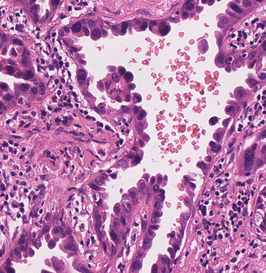

In [31]:
### Example ###
example = '/content/val/2.validation/img/00.png'
img = Image.open(example)
img

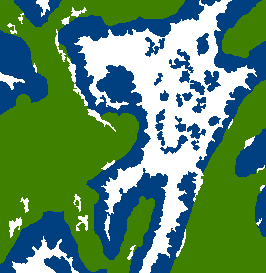

In [32]:
mask = Image.open(example.replace("img", "mask"))
mask

In [ ]:
# Apply transforms to imagr and add batch dimension
tensor = data_transforms["val"](Image.open(example)).unsqueeze(0)

with torch.no_grad():
    pred = model(tensor.to(device))

print(pred.cpu().argmax(1))

tensor([3])


From the mask we can see that the image contains both Tumor and Stromal tissue. (And white background)

Hence the label should be 3 (according to the CODE_LABEL_MAP we defined earlier).

The model correctly predicts the label. The model has a validation accuracy of 75% and matches the dummy on accuracy. However, its F1 score is much higher than that of our dummay classifier, since it better handles False Positives. Our dummy classifier has False Positive rates of 100%, as if we consider class 3 as the positive, all other samples are also labelled as class 3.

To further progress on this problem I would:
- Use a balanced sampler (e.g. few images with label 4)
- Collect more data


##### Segmentation

In this sub-module we will build a model to segment a pathology type in the images.

Tumor epithelial tissue : (0, 64, 128), (one-hot label: 0)

Tumor stromal tisse: (64, 128, 0), (one-hot label: 1)

Normal tissue:  (243, 152, 0), (one-hot label: 2)

White background: (255, 255, 255), (one-hot label: 3)


There are no segmentation labels given for the training data, hence we will split the validation data into a tiny train and val set.

###### Segmentation examples

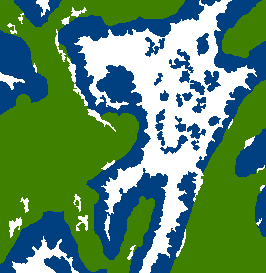

In [ ]:
from PIL import Image

img = Image.open('/content/val/2.validation/mask/00.png')
img

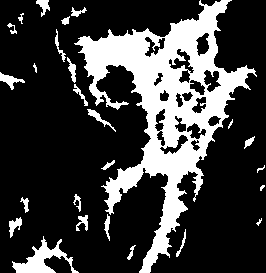

In [ ]:
img = Image.open('/content/val/2.validation/background-mask/00.png')
img

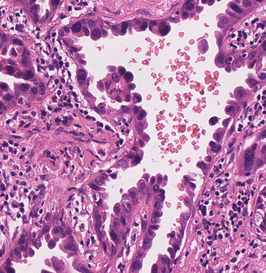

In [ ]:
img = Image.open('/content/val/2.validation/img/00.png')
img

###### Background segmentation

In this sub-module we will only try to segment the background, hence a binary segmentation.





In [ ]:
from torchvision import datasets, models, transforms

data_transforms = {
    'img': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # Standard ImageNet means
    ]),
    'mask': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
    ]),
}

In [ ]:
import cv2
from PIL import Image
import os
import torch
from torch.utils.data import Dataset, DataLoader


class PathologySegDataset(Dataset):
    def __init__(self, img_paths, mask_paths, img_transform=None, mask_transform=None):     
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.img_transform = img_transform
        self.mask_transform = mask_transform
                  
    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        mask_path = self.mask_paths[idx]

        image = Image.open(img_path)
        mask = Image.open(mask_path)

        image = self.img_transform(image)
        # Multiply by 255 to turn 0.0039 into 1 & turn into a tensor of ints for classification
        mask = (self.mask_transform(mask) * 255).long()

        return image, mask



In [ ]:
val_path = "/content/val/2.validation/img/"
val_bkmask_path = "/content/val/2.validation/background-mask/"

img_paths = [os.path.join(val_path, path) for path in os.listdir(val_path) if (".png" in path) and ("._" not in path)]
mask_paths = [os.path.join(val_bkmask_path, path) for path in os.listdir(val_bkmask_path) if (".png" in path) and ("._" not in path)]

# Using two samples for validation
train_dataset = PathologySegDataset(img_paths=img_paths[:-2], mask_paths=mask_paths[:-2], 
                                    img_transform=data_transforms["img"], mask_transform=data_transforms["mask"])

val_dataset = PathologySegDataset(img_paths=img_paths[-2:], mask_paths=mask_paths[-2:],
                                  img_transform=data_transforms["img"], mask_transform=data_transforms["mask"])

batch_size = 4

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

dataset_sizes = {"train": len(train_dataset), "val": len(val_dataset)}
dataloaders = {"train": train_dataloader, "val": val_dataloader}

print("Dataset sizes:", dataset_sizes)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Dataset sizes: {'train': 38, 'val': 2}


In [ ]:
import copy
import time

def train_model(model, criterion, optimizer, scheduler=None, num_epochs=25, report_step=50, use_wandb=False):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = float("inf")

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss, running_corrects = [], []

            # Iterate over data.
            for step, (inputs, masks) in enumerate(dataloaders[phase]):
                inputs = inputs.to(device)
                masks = masks.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)

                    # BCEW/Logits expects targets to be floats
                    loss = criterion(outputs['out'].squeeze(), masks.float().squeeze())
                    preds = torch.sigmoid(outputs['out'].detach()) > 0.5 # Base probability threshold for sigmoid

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        # Scheduler will update every X steps as specified in its config
                        if scheduler: scheduler.step()

                # statistics
                running_loss.append(loss.item() * inputs.size(0))
                running_corrects.extend((preds ==  masks.data).flatten().tolist())
              
                if (phase == 'train') and (step % report_step == 0):
                    report_loss = sum(running_loss) / len(running_loss)
                    report_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100
                    
                    if use_wandb:
                        wandb.log({"loss": epoch_clf_loss, "acc": epoch_corrects})
                    else:
                        print('{} Step: {} Loss: {:.4f} Acc: {:.2f}%'.format(phase, step, report_loss, report_corrects))
                    
                    running_loss, running_corrects = [], []
            
            if phase == 'val':
                epoch_loss = sum(running_loss) / len(running_loss)
                epoch_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100

                print('{} Step: {} Loss: {:.4f} Acc: {:.2f}%'.format(phase, step, epoch_loss, epoch_corrects))
                # deep copy the model
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = copy.deepcopy(model.state_dict())


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val loss: {:4f}'.format(best_loss))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
model = models.segmentation.deeplabv3_resnet101(pretrained=True,
                                                progress=True)
model.classifier = models.segmentation.deeplabv3.DeepLabHead(2048, 1)

# Use BCEW/Logits as we just have 1 output, so it'll apply sigmoid & compute CE for us
criterion = torch.nn.BCEWithLogitsLoss(reduction='mean')
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

model.to(device)

best_model = train_model(model, criterion, optimizer, num_epochs=20, report_step=5, use_wandb=False)

Epoch 0/19
----------
train Step: 0 Loss: 2.6742 Acc: 62.00%
train Step: 5 Loss: 2.3069 Acc: 72.82%
val Step: 0 Loss: 1.3518 Acc: 66.38%
Epoch 1/19
----------
train Step: 0 Loss: 2.0847 Acc: 74.21%
train Step: 5 Loss: 1.8925 Acc: 80.23%
val Step: 0 Loss: 1.1993 Acc: 70.71%
Epoch 2/19
----------
train Step: 0 Loss: 1.7777 Acc: 82.04%
train Step: 5 Loss: 1.5569 Acc: 84.64%
val Step: 0 Loss: 1.1407 Acc: 70.61%
Epoch 3/19
----------
train Step: 0 Loss: 1.5552 Acc: 85.94%
train Step: 5 Loss: 1.4673 Acc: 85.36%
val Step: 0 Loss: 1.0221 Acc: 75.27%
Epoch 4/19
----------
train Step: 0 Loss: 1.2806 Acc: 87.09%
train Step: 5 Loss: 1.7319 Acc: 82.06%
val Step: 0 Loss: 1.0950 Acc: 73.33%
Epoch 5/19
----------
train Step: 0 Loss: 1.6930 Acc: 80.18%
train Step: 5 Loss: 1.2599 Acc: 88.42%
val Step: 0 Loss: 0.9461 Acc: 76.65%
Epoch 6/19
----------
train Step: 0 Loss: 1.3326 Acc: 85.80%
train Step: 5 Loss: 1.2514 Acc: 87.81%
val Step: 0 Loss: 0.9045 Acc: 78.15%
Epoch 7/19
----------
train Step: 0 Loss:

In [ ]:
example = "/content/val/2.validation/img/00.png"

def get_mask(img_path, proba_thresh=0.5):
    base_img = Image.open(img_path)
    img = data_transforms["img"](base_img).unsqueeze(0)
    with torch.no_grad():
        pred = best_model(img.to(device))
    # We apply sigmoid on the first batch; remove the channel dim & filter for whats larger than our thresh
    mask = Image.fromarray(np.uint8((torch.sigmoid(pred["out"][0, ...]).cpu().squeeze() > proba_thresh) * 255), 'L').resize(base_img.size)
    return mask

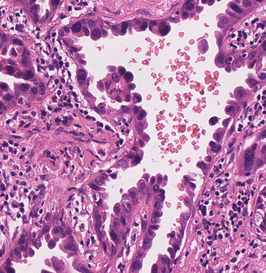

In [ ]:
### Original Image ###
Image.open(example)

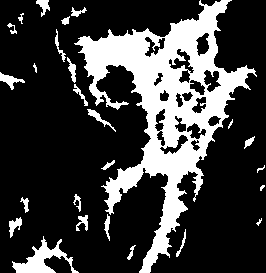

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "background-mask"))

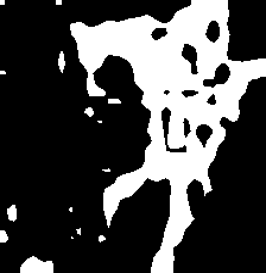

In [ ]:
### Prediction ###
get_mask(example)

In [ ]:
example = "/content/val/2.validation/img/01.png"

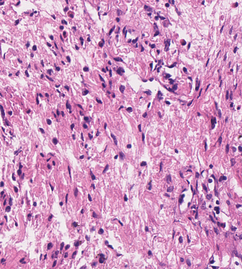

In [ ]:
### Original Image ###
Image.open(example)

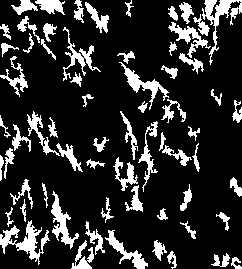

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "background-mask"))

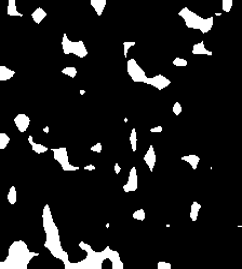

In [ ]:
### Prediction ###
get_mask(example)

The model is pretty good.

###### Full segmentation

In this sub-module, we will try to segment all elements, i.e. the tumor tissue, stromal tissue, normal tissue & the background.

In [ ]:
val_path = "/content/val/2.validation/img/"
val_mask_path = "/content/val/2.validation/mask/"

img_paths = [os.path.join(val_path, path) for path in os.listdir(val_path) if (".png" in path) and ("._" not in path)]
mask_paths = [os.path.join(val_mask_path, path) for path in os.listdir(val_bkmask_path) if (".png" in path) and ("._" not in path)]

# Using two samples for validation
train_dataset = PathologySegDataset(img_paths=img_paths[:-2], mask_paths=mask_paths[:-2], 
                                    img_transform=data_transforms["img"], mask_transform=data_transforms["mask"])

val_dataset = PathologySegDataset(img_paths=img_paths[-2:], mask_paths=mask_paths[-2:],
                                  img_transform=data_transforms["img"], mask_transform=data_transforms["mask"])

batch_size = 4

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

dataset_sizes = {"train": len(train_dataset), "val": len(val_dataset)}
dataloaders = {"train": train_dataloader, "val": val_dataloader}

print("Dataset sizes:", dataset_sizes)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Dataset sizes: {'train': 38, 'val': 2}


In [ ]:
import copy
import time

def train_model(model, criterion, optimizer, scheduler=None, num_epochs=25, report_step=50, use_wandb=False):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = np.inf

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss, running_corrects = [], []

            # Iterate over data.
            for step, (inputs, masks) in enumerate(dataloaders[phase]):
                inputs = inputs.to(device)
                masks = masks.to(device).squeeze() # Remove the Grayscale dim

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs['out'].squeeze(), masks.long())
                    _, preds = torch.max(outputs['out'].detach(), 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        # Scheduler will update every X steps as specified in its config
                        if scheduler: scheduler.step()

                # statistics
                running_loss.append(loss.item() * inputs.size(0))
                running_corrects.extend((preds ==  masks.data).flatten().tolist())

                if (phase == 'train') and (step % report_step == 0):
                    report_loss = sum(running_loss) / len(running_loss)
                    report_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100
                    
                    if use_wandb:
                        wandb.log({"loss": epoch_clf_loss, "acc": epoch_corrects})
                    else:
                        print('{} Step: {} Loss: {:.4f} Acc: {:.2f}%'.format(phase, step, report_loss, report_corrects))
                    
                    running_loss, running_corrects = [], []
            
            if phase == 'val':
                epoch_loss = sum(running_loss) / len(running_loss)
                epoch_corrects = round(sum(running_corrects) / len(running_corrects), 4) * 100

                print('{} Step: {} Loss: {:.4f} Acc: {:.2f}%'.format(phase, step, epoch_loss, epoch_corrects))
                # deep copy the model
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = copy.deepcopy(model.state_dict())


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val loss: {:4f}'.format(best_loss))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
model = models.segmentation.deeplabv3_resnet101(pretrained=True,
                                                progress=True)
model.classifier = models.segmentation.deeplabv3.DeepLabHead(2048, 4)

criterion = torch.nn.CrossEntropyLoss(reduction='mean')
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

num_epochs = 20
report_step = 5

model.to(device)

best_model = train_model(model, criterion, optimizer, num_epochs=num_epochs, report_step=report_step, use_wandb=False)

Epoch 0/19
----------
train Step: 0 Loss: 5.7086 Acc: 27.64%
train Step: 5 Loss: 5.4076 Acc: 37.02%
val Step: 0 Loss: 2.5762 Acc: 50.11%
Epoch 1/19
----------
train Step: 0 Loss: 4.5485 Acc: 52.72%
train Step: 5 Loss: 4.4025 Acc: 54.88%
val Step: 0 Loss: 2.3504 Acc: 58.68%
Epoch 2/19
----------
train Step: 0 Loss: 3.6425 Acc: 69.82%
train Step: 5 Loss: 3.8323 Acc: 60.53%
val Step: 0 Loss: 1.9947 Acc: 64.30%
Epoch 3/19
----------
train Step: 0 Loss: 3.2247 Acc: 69.76%
train Step: 5 Loss: 3.3612 Acc: 66.94%
val Step: 0 Loss: 1.9836 Acc: 60.51%
Epoch 4/19
----------
train Step: 0 Loss: 2.6514 Acc: 79.94%
train Step: 5 Loss: 2.9958 Acc: 70.79%
val Step: 0 Loss: 1.9925 Acc: 52.27%
Epoch 5/19
----------
train Step: 0 Loss: 2.3708 Acc: 80.24%
train Step: 5 Loss: 2.5193 Acc: 77.31%
val Step: 0 Loss: 2.2494 Acc: 47.20%
Epoch 6/19
----------
train Step: 0 Loss: 2.7820 Acc: 73.46%
train Step: 5 Loss: 2.4831 Acc: 76.86%
val Step: 0 Loss: 1.5551 Acc: 68.61%
Epoch 7/19
----------
train Step: 0 Loss:

In [ ]:
example = "/content/val/2.validation/img/00.png"

def get_mask(img):
    # Transform & add batch dimension
    tensor = data_transforms["img"](img).unsqueeze(0)
    # Feed through model
    with torch.no_grad():
        pred = best_model(tensor.to(device))
    output_predictions = pred["out"][0].argmax(0)

    # create a color pallette, selecting a color for each class
    colors = np.array([[0, 64, 128], # Tumor epithelial tissue (0)
                      [64, 128, 0], # Tumor stromal tisse (1)
                      [243, 152, 0], # Normal tissue (2)
                      [255, 255, 255], # White background (3) 
    ], dtype=np.uint8)

    out = Image.fromarray(output_predictions.byte().cpu().numpy()).resize(img.size)
    out.putpalette(colors)

    return out

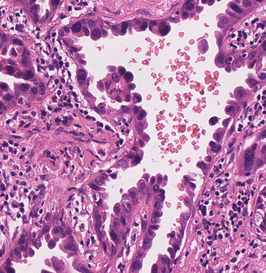

In [ ]:
### Original ###
Image.open(example)

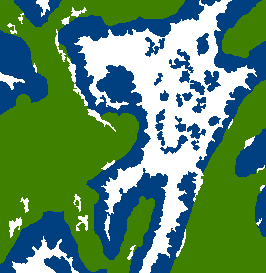

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "mask"))

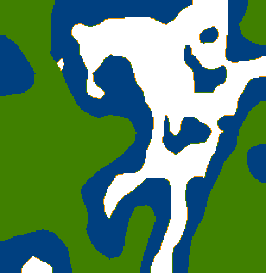

In [ ]:
### Predictions ###
get_mask(Image.open(example))

In [ ]:
example = "/content/val/2.validation/img/30.png"

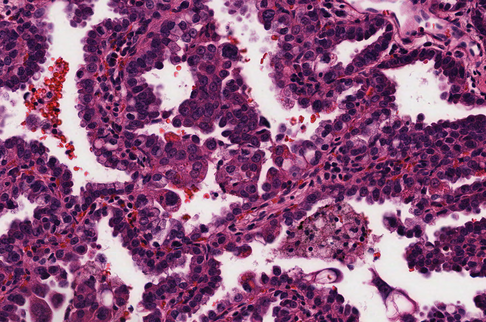

In [ ]:
### Original ###
Image.open(example)

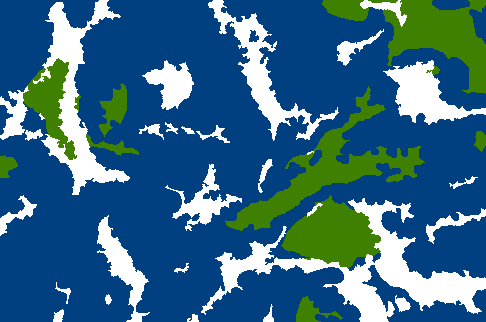

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "mask"))

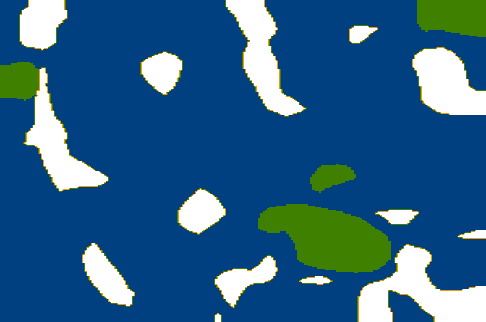

In [ ]:
### Predictions ###
get_mask(Image.open(example))

In [ ]:
example = "/content/val/2.validation/img/02.png"

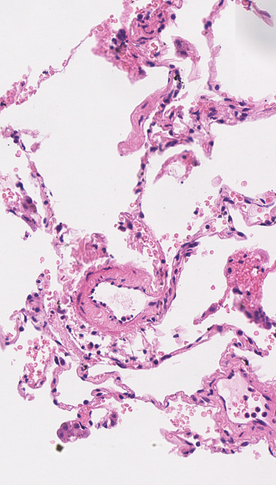

In [ ]:
### Original ###
Image.open(example)

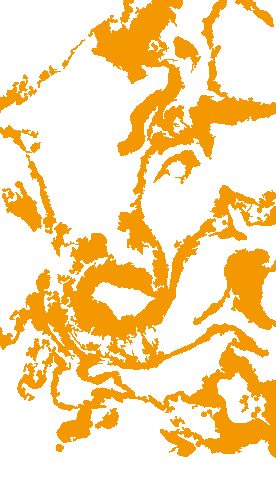

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "mask"))

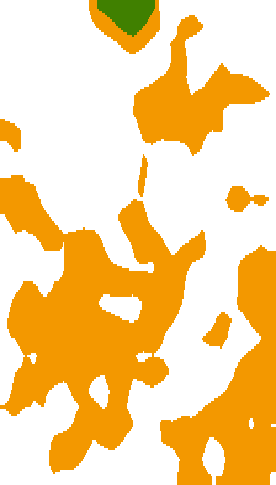

In [ ]:
### Predictions ###
get_mask(Image.open(example))

In [ ]:
example = "/content/val/2.validation/img/38.png"

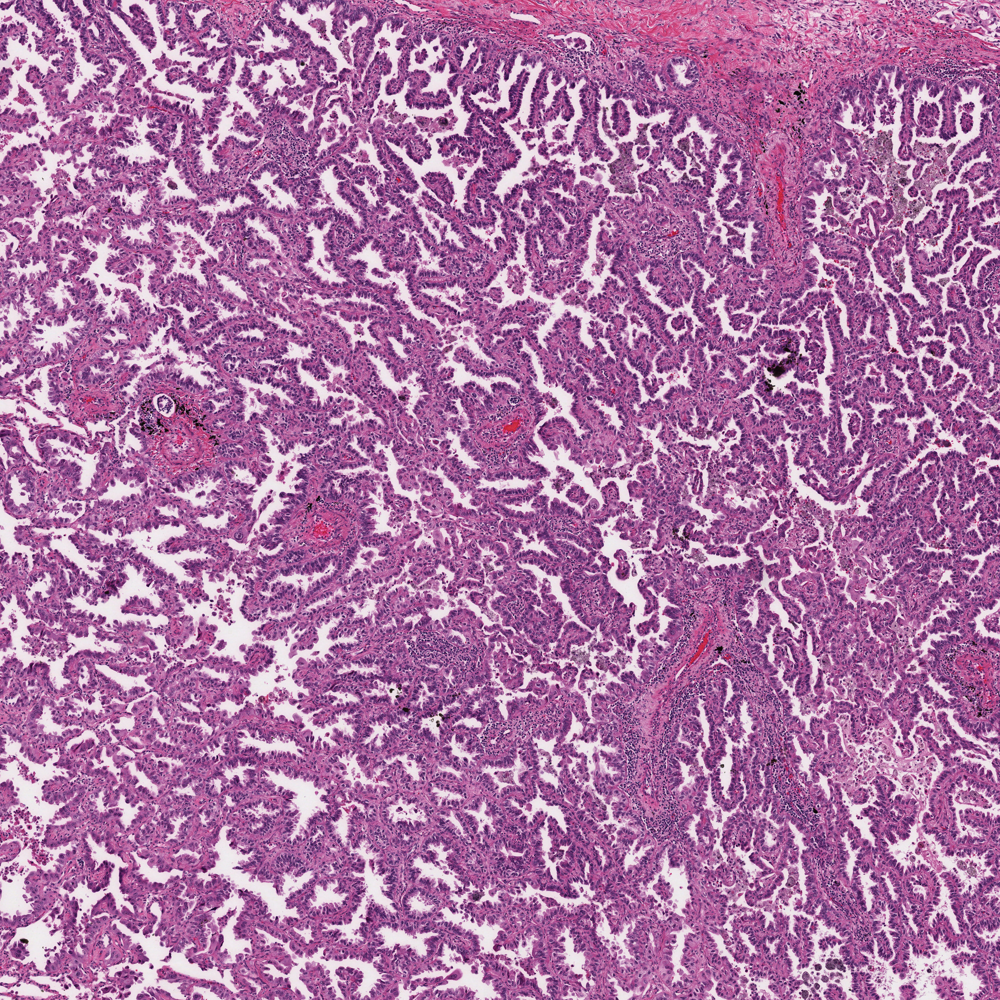

In [ ]:
### Original ###
Image.open(example)

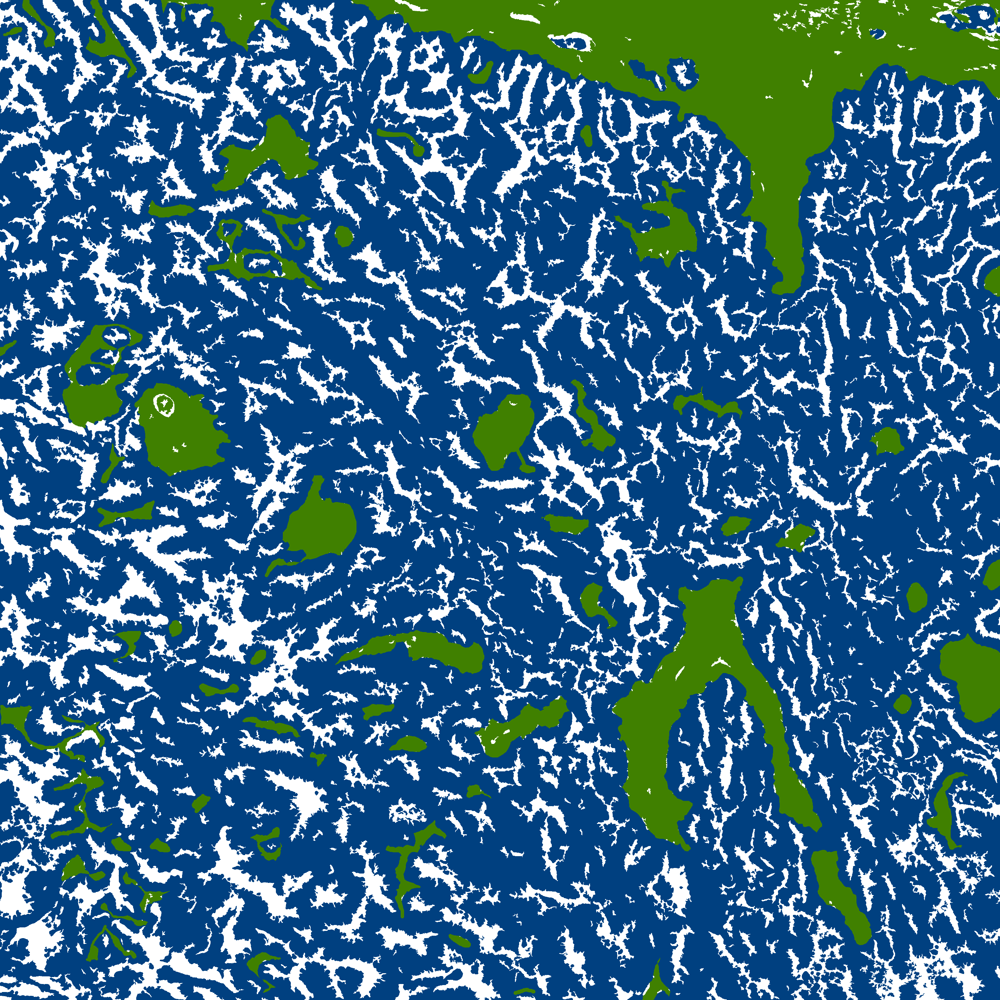

In [ ]:
### Original Mask ###
Image.open(example.replace("img", "mask"))

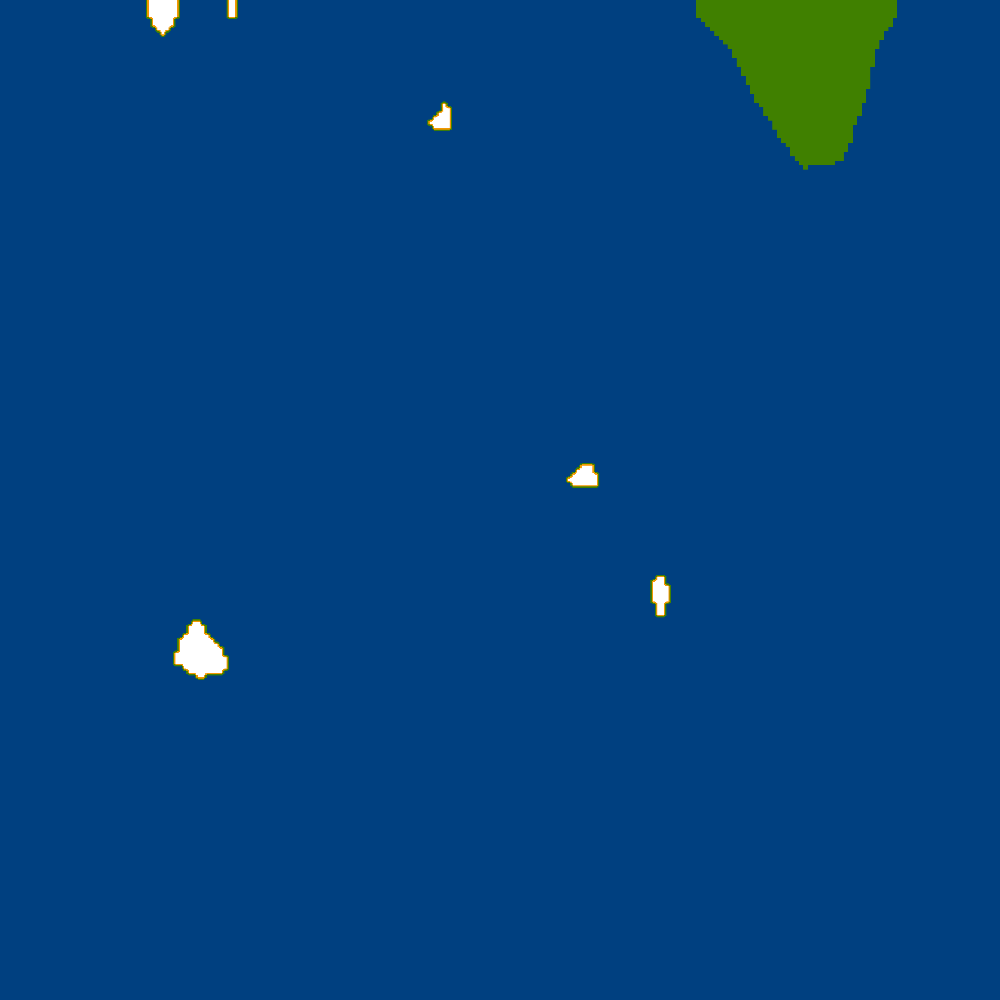

In [ ]:
### Predictions ###
get_mask(Image.open(example))

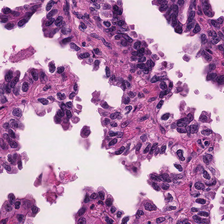

In [ ]:
# Take just the upper left corner of the huge image - With a size that fits our model perfectly
im = Image.open(example)
#  (left, upper, right, lower)
crop_rectangle = (0, 0, 224, 224)
cropped_im = im.crop(crop_rectangle)
cropped_im

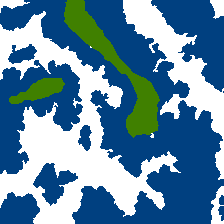

In [ ]:
mask = Image.open(example.replace("img", "mask"))
#  (left, upper, right, lower)
crop_rectangle = (0, 0, 224, 224)
cropped_mask = mask.crop(crop_rectangle)
cropped_mask

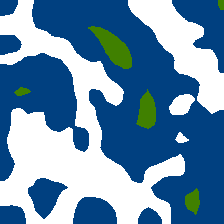

In [ ]:
### Predictions ###
get_mask(cropped_im)

The model does a fair job.

The last example is interesting, because it shows the limits of our current approach. We are currently shrinking the image to (224,224), but the last example is an image of size (2878, 2878), hence we lose about 90% of all its pixels when we scale it to 224x224. We then perform our predictions in 224x224 and scale it back up again. Scaling back up however just fills the missing pixels with their neighbors and hence we get large areas of the same prediction.

When just selecting the upper left 224x224 corner of the image, we can see that we get reasonable results. 

Hence ideally we always preprocess test images first into patches of 224x224 or we increase the perceptive field of our model.

#### Final Words

This was fun! :)

Possible improvements:
- Conduct more detailed EDA
- Compute IoUs for segmentation
- Try to learn segmentation from images without label segmentation

Sources:
- PyTorch Documentation
- PIL Documentation
- https://wsss4luad.grand-challenge.org/Datasets/
